In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import requests
import xmltodict
from astropy.time import Time
from astropy.table import Table
import astropy.cosmology as cos
from astropy.cosmology import Planck15 as cosmo
import astropy.units as u
import base64
from io import BytesIO
from ligo.gracedb.rest import GraceDb

g = GraceDb()

In [7]:
# test event :
gracedbid = "S250319bu"
event_files = g.files(gracedbid).json()
selected_url = [value for key, value in event_files.items() if "xml" in key][-1]
print(f"getting data from {selected_url}")
response = requests.get(selected_url).text
dict = xmltodict.parse(response)

# get skymap_str
skymap_url = [
    item["Param"]["@value"]
    for item in dict["voe:VOEvent"]["What"]["Group"]
    if item.get("@name") == "GW_SKYMAP"
][0]
skymap_response = requests.get(skymap_url)
skymap_bytes = skymap_response.content
skymap = Table.read(BytesIO(skymap_bytes))
skymap_str = base64.b64encode(skymap_bytes).decode("utf-8")

# get dateobs
obsmjd = skymap.meta["MJD-OBS"]
dateobs = Time((obsmjd + 2400000.5), format="jd").fits

# get redshift
distmean = skymap.meta["DISTMEAN"]
diststd = skymap.meta["DISTSTD"]
if distmean - 3 * diststd > 0:
    zmin = cos.z_at_value(
        cosmo.luminosity_distance,
        (distmean - 3 * diststd) * u.Mpc,
        method="bounded",
    ).value
else:
    zmin = 0
zmax = cos.z_at_value(
    cosmo.luminosity_distance,
    (distmean + 3 * diststd) * u.Mpc,
    method="bounded",
).value

event = [gracedbid, skymap_str, dateobs, zmin, zmax]

getting data from https://gracedb.ligo.org/api/superevents/S250319bu/files/S250319bu-5-Update.xml,0


In [8]:
# connect kowalski

from penquins import Kowalski
import yaml

with open("../config/Credentials.yaml", "r") as file:
    credentials = yaml.safe_load(file)
kowalski_username = credentials["kowalski_username"]
kowalski_password = credentials["kowalski_password"]

instances = {
    "kowalski": {
        "name": "kowalski",
        "host": "kowalski.caltech.edu",
        "protocol": "https",
        "port": 443,
        "username": kowalski_username,
        "password": kowalski_password,
        "timeout": 6000,
    },
    "gloria": {
        "name": "gloria",
        "host": "gloria.caltech.edu",
        "protocol": "https",
        "port": 443,
        "username": kowalski_username,
        "password": kowalski_password,
        "timeout": 6000,
    },
}

k = Kowalski(instances=instances)

In [9]:
# add skymaps to gloria, kowalski


def load_skymap_kowalski(alert, contour):
    skymap_data = {
        "localization_name": alert[0],
        "content": alert[1],
    }

    k.api(
        "put",
        "api/skymap",
        data={"dateobs": alert[2], "skymap": skymap_data, "contours": contour},
        name="kowalski",
    )


def load_skymap_gloria(alert, contour):
    skymap_data = {
        "localization_name": alert[0],
        "content": alert[1],
    }

    k.api(
        "put",
        "api/skymap",
        data={"dateobs": alert[2], "skymap": skymap_data, "contours": contour},
        name="gloria",
    )


load_skymap_kowalski(event, 90)
load_skymap_gloria(event, 90)

In [11]:
# retrieve all alerts associated with the skymap over 50 days


def crossmatch_alerts(alert, contour):
    projection_flat = {
        "_id": 0,
        "objectId": 1,
        "isdiffpos": "$candidate.isdiffpos",
        "magpsf": "$candidate.magpsf",
        "sgscore1": "$candidate.sgscore1",
        "drb": "$candidate.drb",
        "bts": "$classifications.bts",
        "acai_v": "$classifications.acai_v",
        "acai_n": "$classifications.acai_n",
        "acai_h": "$classifications.acai_h",
        "ra": "$candidate.ra",
        "dec": "$candidate.dec",
    }
    mintime = round(Time(event[2]).jd)
    maxtime = mintime + 50

    query = {
        "query_type": "skymap",
        "query": {
            "skymap": {
                "localization_name": alert[0],
                "contour": contour,
                "dateobs": alert[2],
            },
            "catalog": "ZTF_alerts",
            "filter": {"candidate.jdstarthist": {"$gte": mintime, "$lte": maxtime}},
            "projection": projection_flat,
        },
    }
    response = k.query(query=query, name="kowalski")
    print(response)
    selected = response.get("kowalski", {}).get("data", [])
    print(f"{len(selected)} alerts found in localization volume")
    return selected


crossmatch_alerts = crossmatch_alerts(event, 90)

{'kowalski': {'status': 'success', 'message': 'Successfully executed query', 'data': [{'objectId': 'ZTF25aajjsoc', 'isdiffpos': 't', 'magpsf': 17.770477294921875, 'sgscore1': 0.9855419993400574, 'drb': 2.3689999579801224e-05, 'bts': 0.488256573677063, 'acai_v': 5.927828169660643e-06, 'acai_n': 2.828830292855855e-05, 'acai_h': 1.8119082900724948e-09, 'ra': 117.030304, 'dec': 41.6708082}, {'objectId': 'ZTF25aangfxt', 'isdiffpos': 't', 'magpsf': 17.322830200195312, 'sgscore1': 0.0, 'drb': 8.700000080352766e-07, 'bts': 0.5681145191192627, 'acai_v': 4.736902496915718e-07, 'acai_n': 2.595089426904451e-06, 'acai_h': 7.448319934155734e-07, 'ra': 117.4626181, 'dec': 41.5403637}, {'objectId': 'ZTF25aapanvd', 'isdiffpos': 't', 'magpsf': 18.203887939453125, 'sgscore1': 0.5, 'drb': 6.374999793479219e-05, 'bts': 0.12144848704338074, 'acai_v': 1.6483550098200794e-06, 'acai_n': 5.539433004742023e-06, 'acai_h': 3.2085651469060394e-07, 'ra': 117.3891488, 'dec': 41.3901294}, {'objectId': 'ZTF25aapaauq', 

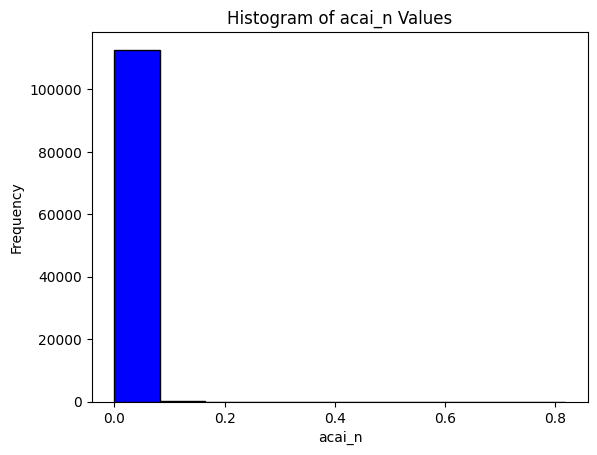

In [71]:
acai_n_values = [entry["acai_n"] for entry in crossmatch_alerts if "acai_n" in entry]

# Create a histogram
plt.hist(acai_n_values, bins=10, color="blue", edgecolor="black")
plt.title("Histogram of acai_n Values")
plt.xlabel("acai_n")
plt.ylabel("Frequency")
plt.show()

In [61]:
# from just the alerts, how many unique objects are there?


def remove_duplicate_object_ids(data):
    seen = set()
    filtered_data = []
    for item in data:
        object_id = item.get("objectId")
        if object_id and object_id not in seen:
            seen.add(object_id)
            filtered_data.append(item)
    print(f"{len(filtered_data)} unique objects found")
    return filtered_data


crossmatch_objects = remove_duplicate_object_ids(crossmatch_alerts)

110187 unique objects found


In [62]:
# if we filter with acai_n, drb, how many are we left with?


def filter_alerts(data, acai_n_threshold=0.5, drb_threshold=0.5):
    filtered_data = []
    for item in data:
        acai_n = item.get("acai_n")
        drb = item.get("drb")
        if acai_n is not None and drb is not None:
            if acai_n > acai_n_threshold and drb > drb_threshold:
                filtered_data.append(item)
    print(f"{len(filtered_data)} alerts left after filtering")
    return filtered_data


filtered_alerts = filter_alerts(
    crossmatch_alerts, acai_n_threshold=0.5, drb_threshold=0.5
)
filtered_unique_objects = remove_duplicate_object_ids(filtered_alerts)

6 alerts left after filtering
4 unique objects found


crossmatch with Quaia, Catnorth, Milliquas, C75

In [13]:
# crossmatch quaia with the ligo skymap


def crossmatch_quaia(alert, contour):
    query = {
        "query_type": "skymap",
        "query": {
            "skymap": {
                "localization_name": alert[0],
                "contour": contour,
                "dateobs": alert[2],
            },
            "catalog": "quaia_G20.5",
            "filter": {"redshift_quaia": {"$gte": alert[3], "$lte": alert[4]}},
            "projection": {
                "_id": 1,
                "ra": 1,
                "dec": 1,
                "redshift_quaia": 1,
                "unwise_objid": 1,
            },
        },
    }
    response_quaia_localization = k.query(query=query, name="kowalski")
    selected_agn = response_quaia_localization.get("kowalski", {}).get("data", [])
    print(len(selected_agn), "AGN found in localization volume")
    return selected_agn


quaia_agn = crossmatch_quaia(event, 90)

16503 AGN found in localization volume


In [14]:
# crossmatch catnorth with the ligo skymap


def crossmatch_catnorth(alert, contour):
    query = {
        "query_type": "skymap",
        "query": {
            "skymap": {
                "localization_name": alert[0],
                "contour": contour,
                "dateobs": alert[2],
            },
            "catalog": "CatNorth",
            "filter": {"z_ph": {"$gte": alert[3], "$lte": alert[4]}},
            "projection": {"source_id": 1, "ra": 1, "dec": 1},
        },
    }
    response_catnorth_localization = k.query(query=query)
    selected_agn = response_catnorth_localization.get("gloria", {}).get("data", [])
    print(len(selected_agn), "AGN found in localization volume")
    return selected_agn


catnorth_agn = crossmatch_catnorth(event, 90)

24284 AGN found in localization volume


In [15]:
def crossmatch_milliquas(alert, contour):
    query = {
        "query_type": "skymap",
        "query": {
            "skymap": {
                "localization_name": alert[0],
                "contour": contour,
                "dateobs": alert[2],
            },
            "catalog": "milliquas_v8",
            "filter": {"Z": {"$gte": alert[3], "$lte": alert[4]}},
            "projection": {"_id": 1, "RA": 1, "DEC": 1},
        },
    }
    response_milliquas_localization = k.query(query=query)
    selected_agn = response_milliquas_localization.get("gloria", {}).get("data", [])
    for item in selected_agn:
        item["ra"] = item.pop("RA", None)
        item["dec"] = item.pop("DEC", None)
    print(len(selected_agn), "AGN found in localization volume")
    return selected_agn


milliquas_agn = crossmatch_milliquas(event, 90)

23503 AGN found in localization volume


In [16]:
# crossmatch C75 with the ligo skymap


def crossmatch_wise(alert, contour):
    query = {
        "query_type": "skymap",
        "query": {
            "skymap": {
                "localization_name": alert[0],
                "contour": contour,
                "dateobs": alert[2],
            },
            "catalog": "WISE_AGN_C75",
            "filter": {},
            "projection": {"WISE ID": 1, "RA": 1, "Dec": 1},
        },
    }
    response_c75_localization = k.query(query=query)
    selected_agn = response_c75_localization.get("gloria", {}).get("data", [])
    for item in selected_agn:
        item["ra"] = item.pop("RA", None)
        item["dec"] = item.pop("Dec", None)
    print(len(selected_agn), "AGN found in localization volume")
    return selected_agn


wise_agn = crossmatch_wise(event, 90)

639629 AGN found in localization volume


find number matches between pairs of catalogs

In [73]:
# function to calculate distance between two ra/dec positions (from Theo!)

DEGRA = np.pi / 180.0


def great_circle_distance(ra1_deg, dec1_deg, ra2_deg, dec2_deg):
    """
        Distance between two points on the sphere
    :param ra1_deg:
    :param dec1_deg:
    :param ra2_deg:
    :param dec2_deg:
    :return: distance in degrees
    """
    # this is orders of magnitude faster than astropy.coordinates.Skycoord.separation

    ra1, dec1, ra2, dec2 = (
        ra1_deg * DEGRA,
        dec1_deg * DEGRA,
        ra2_deg * DEGRA,
        dec2_deg * DEGRA,
    )
    delta_ra = np.abs(ra2 - ra1)
    distance = np.arctan2(
        np.sqrt(
            (np.cos(dec2) * np.sin(delta_ra)) ** 2
            + (
                np.cos(dec1) * np.sin(dec2)
                - np.sin(dec1) * np.cos(dec2) * np.cos(delta_ra)
            )
            ** 2
        ),
        np.sin(dec1) * np.sin(dec2) + np.cos(dec1) * np.cos(dec2) * np.cos(delta_ra),
    )

    return distance * 180.0 / np.pi


def find_agn_in_common_slow(catalog1, catalog2, radius=3):
    """
    Find AGN in common between two catalogs
    :param catalog1: first catalog AGN, as a list of dictionaries with keys ra and dec for each AGN
    :param catalog2: second catalog AGN, as a list of dictionaries with keys ra and dec for each AGN
    :param radius: search radius in arcseconds
    :return: list of AGN coordinates in common
    """
    agn_in_common = []
    for agn1 in catalog1:
        for agn2 in catalog2:
            distance = great_circle_distance(
                agn1["ra"], agn1["dec"], agn2["ra"], agn2["dec"]
            )
            if distance < radius / 3600.0:
                agn_in_common.append(agn1)
                break
    print(f"Found {len(agn_in_common)} AGN in common")
    return agn_in_common

In [17]:
# needed a faster solution to above

from scipy.spatial import cKDTree
import numpy as np


def find_agn_in_common(catalog1, catalog2, radius=5):
    """
    Find AGN in common between two catalogs
    :param catalog1: first catalog AGN, as a list of dictionaries with keys ra and dec for each AGN
    :param catalog2: second catalog AGN, as a list of dictionaries with keys ra and dec for each AGN
    :param radius: search radius in arcseconds
    :return: list of AGN coordinates in common
    """
    # Convert radius from arcseconds to degrees
    radius_deg = radius / 3600.0

    # Extract RA and DEC from both catalogs and convert to numpy arrays
    catalog1_coords = np.array([[agn["ra"], agn["dec"]] for agn in catalog1])
    catalog2_coords = np.array([[agn["ra"], agn["dec"]] for agn in catalog2])

    # Build a KDTree for the second catalog
    tree = cKDTree(catalog2_coords)

    # Query the KDTree for points within the radius for each point in catalog1
    agn_in_common = []
    for i, coord in enumerate(catalog1_coords):
        indices = tree.query_ball_point(coord, radius_deg)
        if indices:  # If there are matches within the radius
            agn_in_common.append(catalog1[i])

    print(f"Found {len(agn_in_common)} AGN in common")
    return agn_in_common

In [18]:
match_quaia_catnorth = find_agn_in_common(quaia_agn, catnorth_agn)

Found 15092 AGN in common


In [19]:
match_quaia_milliquas = find_agn_in_common(quaia_agn, milliquas_agn)

Found 7946 AGN in common


In [20]:
match_quaia_c75 = find_agn_in_common(quaia_agn, wise_agn)

Found 13137 AGN in common


In [29]:
match_quaia_alerts = find_agn_in_common(quaia_agn, crossmatch_objects)

Found 8 AGN in common


In [64]:
match_quaia_filtered_alerts = find_agn_in_common(quaia_agn, filtered_unique_objects)

Found 0 AGN in common


In [21]:
match_catnorth_milliquas = find_agn_in_common(catnorth_agn, milliquas_agn)

Found 10376 AGN in common


In [22]:
match_catnorth_c75 = find_agn_in_common(catnorth_agn, wise_agn)

Found 18233 AGN in common


In [30]:
match_catnorth_alerts = find_agn_in_common(catnorth_agn, crossmatch_objects)

Found 13 AGN in common


In [63]:
match_catnorth_filtered_alerts = find_agn_in_common(
    catnorth_agn, filtered_unique_objects
)

Found 0 AGN in common


In [23]:
match_milliquas_c75 = find_agn_in_common(milliquas_agn, wise_agn)

Found 13726 AGN in common


In [31]:
match_milliquas_alerts = find_agn_in_common(milliquas_agn, crossmatch_objects)

Found 16 AGN in common


In [65]:
match_milliquas_filtered_alerts = find_agn_in_common(
    milliquas_agn, filtered_unique_objects
)

Found 0 AGN in common


In [34]:
match_c75_alerts = find_agn_in_common(wise_agn, crossmatch_objects)

Found 266 AGN in common


In [66]:
match_c75_filtered_alerts = find_agn_in_common(wise_agn, filtered_unique_objects)

Found 0 AGN in common


In [68]:
# make table with rows = each catalog, columns = number AGN, number (% overlap) with each other catalog and with the alerts


number_objects = [
    len(quaia_agn),
    len(catnorth_agn),
    len(milliquas_agn),
    len(wise_agn),
    len(crossmatch_objects),
    len(filtered_unique_objects),
]
quaia = [
    "",
    len(match_quaia_catnorth),
    len(match_quaia_milliquas),
    len(match_quaia_c75),
    len(match_quaia_alerts),
    len(match_quaia_filtered_alerts),
]
catnorth = [
    len(match_quaia_catnorth),
    "",
    len(match_catnorth_milliquas),
    len(match_catnorth_c75),
    len(match_catnorth_alerts),
    len(match_catnorth_filtered_alerts),
]
milliquas = [
    len(match_quaia_milliquas),
    len(match_catnorth_milliquas),
    "",
    len(match_milliquas_c75),
    len(match_milliquas_alerts),
    len(match_milliquas_filtered_alerts),
]
c75 = [
    len(match_quaia_c75),
    len(match_catnorth_c75),
    len(match_milliquas_c75),
    "",
    len(match_c75_alerts),
    len(match_c75_filtered_alerts),
]
alerts = [
    len(match_quaia_alerts),
    len(match_catnorth_alerts),
    len(match_milliquas_alerts),
    len(match_c75_alerts),
    "",
    len(filtered_unique_objects),
]
filtered_alerts = [
    len(match_quaia_filtered_alerts),
    len(match_catnorth_filtered_alerts),
    len(match_milliquas_filtered_alerts),
    len(match_c75_filtered_alerts),
    len(filtered_unique_objects),
    "",
]

data = {
    "Number AGN": number_objects,
    "Quaia": quaia,
    "Catnorth": catnorth,
    "Milliquas": milliquas,
    "C75": c75,
    "Alerts": alerts,
    "Filtered Alerts": filtered_alerts,
}

index_names = ["Quaia", "Catnorth", "Milliquas", "C75", "Alerts", "Filtered Alerts"]
df = pd.DataFrame(data, index=index_names)
df

,Number AGN,Quaia,Catnorth,Milliquas,C75,Alerts,Filtered Alerts
Quaia,16503,,15092,7946,13137,8,0
Catnorth,24284,15092,,10376,18233,13,0
Milliquas,23503,7946,10376,,13726,16,0
C75,639629,13137,18233,13726,,266,0
Alerts,110187,8,13,16,266,,4
Filtered Alerts,4,0,0,0,0,4,


In [48]:
# make coord diagram for overlaps
import holoviews as hv
from holoviews import opts, dim

In [58]:
# 0=quaia, 1=catnorth, 2=milliquas, 3=c75, 4=alerts

counts = [
    len(match_quaia_catnorth),
    len(match_quaia_milliquas),
    len(match_quaia_c75),
    len(match_quaia_alerts),
    len(match_catnorth_milliquas),
    len(match_catnorth_c75),
    len(match_catnorth_alerts),
    len(match_milliquas_c75),
    len(match_milliquas_alerts),
    len(match_c75_alerts),
]

data = {
    "source": [0, 0, 0, 0, 1, 1, 1, 2, 2, 3],
    "target": [1, 2, 3, 4, 2, 3, 4, 3, 4, 4],
    "value": counts,
}

links = pd.DataFrame(data)

categories = ["Quaia", "Catnorth", "Milliquas", "C75", "Alerts"]
groups = [0, 1, 2, 3, 4]
node_data = [
    {"name": category, "group": group} for category, group in zip(categories, groups)
]
nodes = hv.Dataset(pd.DataFrame(node_data), "index")

In [51]:
from bokeh.sampledata.les_mis import data

In [49]:
nodes.data.head

<bound method NDFrame.head of         name  group  index
0      Quaia      0      0
1   Catnorth      1      1
2  Milliquas      2      2
3        C75      3      3
4     Alerts      4      4>

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
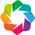

:Chord   [source,target]   (value)

In [60]:
hv.extension("bokeh")
hv.output(size=300)

# Chord diagram
chord = hv.Chord((links, nodes))  # .select(value=(5, None))

chord.opts(
    opts.Chord(
        cmap="Category20",
        edge_cmap="Category20",
        edge_color=dim("source").str(),
        labels="name",
        node_color=dim("index").str(),
        title="AGN Catalog Comparison",
    )
)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
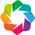

:Chord   [source,target]   (value)

In [47]:
import pandas as pd
import holoviews as hv
from holoviews import opts, dim

hv.extension("bokeh")
hv.output(size=300)

# Example nodes data
categories = ["Quaia", "Catnorth", "Milliquas", "C75", "Alerts"]
groups = [0, 1, 2, 3, 4]
node_data = [{"name": str(f), "group": g} for f, g in zip(categories, groups)]
node_df = pd.DataFrame(node_data)
node_df["index"] = node_df.index  # Add index column
nodes = hv.Dataset(node_df)

# Example links data
links_data = [
    {"source": 0, "target": 1, "value": 10},
    {"source": 1, "target": 2, "value": 15},
    {"source": 2, "target": 3, "value": 20},
    {"source": 3, "target": 4, "value": 25},
]
links = pd.DataFrame(links_data)

# Chord diagram
chord = hv.Chord((links, nodes))

# Chord options
chord.opts(
    opts.Chord(
        cmap="Category20",
        edge_cmap="Category20",
        edge_color=dim("source").str(),
        labels="name",  # Ensure this matches the column in nodes
        node_color=dim("index").str(),
        title="AGN Catalog Comparison",
    )
)

chord

In [ ]:
# clean up


def delete_skymaps(alert):
    k.api(
        "delete",
        "api/skymap",
        data={"dateobs": alert[2], "localization_name": alert[0]},
        name="kowalski",
    )
    k.api(
        "delete",
        "api/skymap",
        data={"dateobs": alert[2], "localization_name": alert[0]},
        name="gloria",
    )


delete_skymaps(event)